In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
from skimage import io
from skimage.io import imread
from imageio import imwrite

import numpy as np
import pandas as pd
import cv2

from scipy.fft import fft2, ifft2, fftshift


from google.colab.patches import cv2_imshow
from skimage.util.dtype import img_as_float
from skimage.filters import laplace,gaussian

from skimage import io, data, img_as_ubyte, img_as_float
from skimage.filters import gaussian, laplace, rank
from skimage.restoration import denoise_bilateral, denoise_nl_means,estimate_sigma
from scipy import ndimage as nd
from skimage.util import random_noise

import glob
import os
import matplotlib.pyplot as plt
from PIL import Image

In [ ]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# Open the image
im = Image.open('/content/drive/MyDrive/dataset/noisy10/0001.png')

# Convert the image to a numpy array
im_array = np.array(im)

In [ ]:
# Split the image into its R, G, and B channels
R, G, B = im_array[:,:,0], im_array[:,:,1], im_array[:,:,2]

# Compute the means and standard deviations of the R, G, and B channels
r_mean, g_mean, b_mean = R.mean(), G.mean(), B.mean()
r_std, g_std, b_std = R.std(), G.std(), B.std()

# Print the results
print(f"R: mean={r_mean:.2f}, std={r_std:.2f}")
print(f"G: mean={g_mean:.2f}, std={g_std:.2f}")
print(f"B: mean={b_mean:.2f}, std={b_std:.2f}")

R: mean=118.15, std=52.80
G: mean=85.83, std=34.07
B: mean=73.50, std=33.75


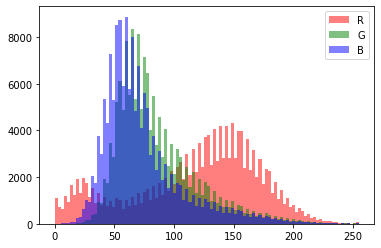

In [ ]:
# Plot the histograms of the R, G, and B channels
plt.hist(R.flatten(), bins=100, alpha=0.5, label='R', color='red')
plt.hist(G.flatten(), bins=100, alpha=0.5, label='G', color='green')
plt.hist(B.flatten(), bins=100, alpha=0.5, label='B', color='blue')
plt.legend()
plt.show()

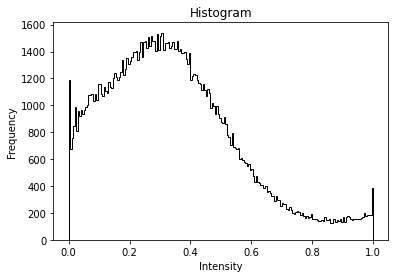

In [ ]:
# Load the image and convert it to grayscale
image1 = io.imread('/content/drive/MyDrive/dataset/noisy50/0004.png',as_gray=True)
v = np.concatenate(image1)
bins = 200
plt.hist(v, bins, color='k', histtype='step')
plt.title("Histogram")
plt.xlabel('Intensity')
plt.ylabel('Frequency')
plt.show()

Apply FFT and Low Pass Filter

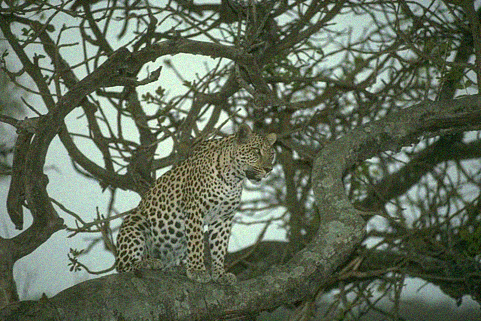

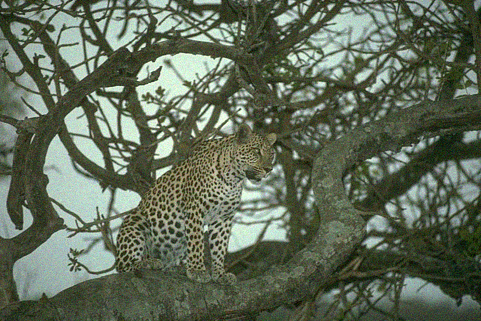

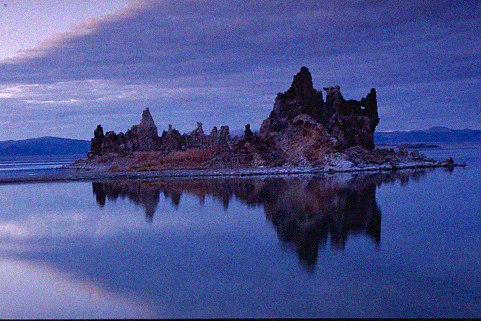

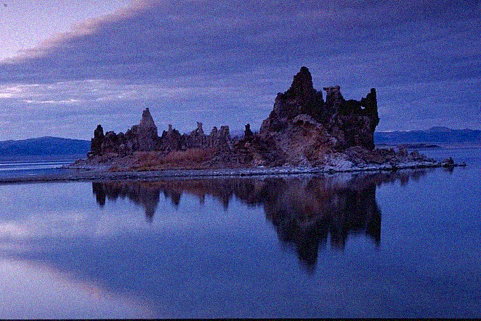

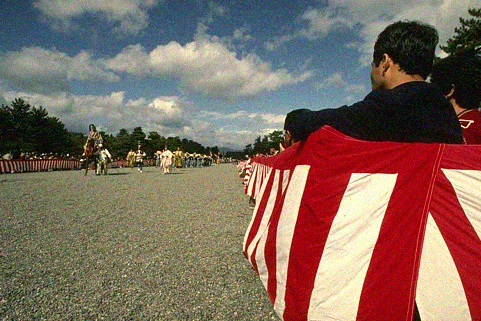

...

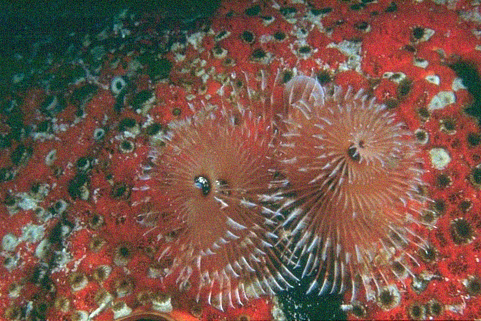

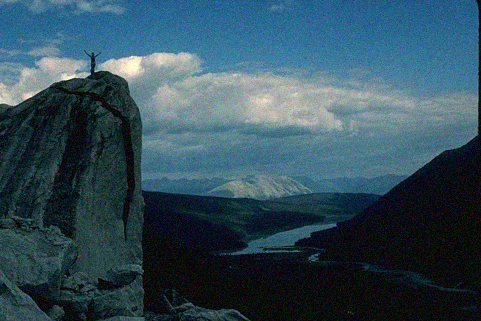

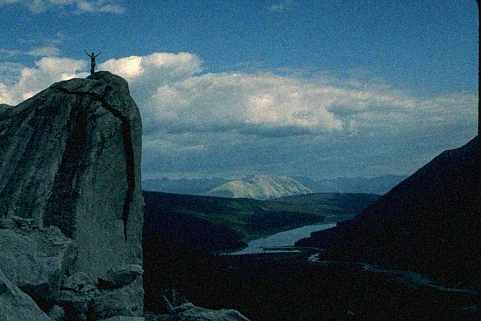

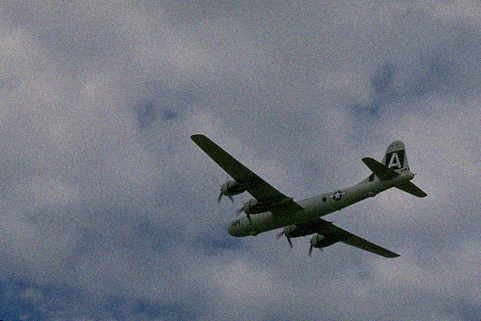

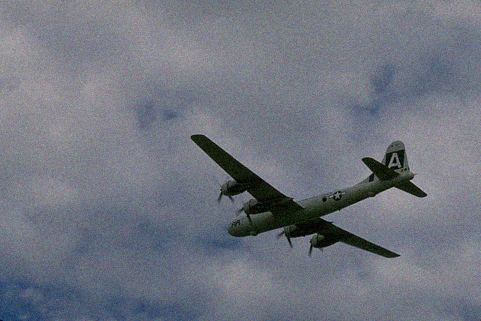

In [ ]:

# Define the path to the folder containing the RGB images
path = "/content/drive/MyDrive/dataset/noisy10"

# Iterate through all the files in the folder
for filename in os.listdir(path):
    # Check if the file is an image
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Read the image
        img = cv2.imread(os.path.join(path, filename))

        cv2_imshow(img)

        # Split the image into its color channels
        blue, green, red = cv2.split(img)

        # Perform FFT on each color channel
        blue_fourier = fft2(blue)
        green_fourier = fft2(green)
        red_fourier = fft2(red)

        # Perform LPF on each color channel
        rows, cols = img.shape[:2]
        center = [int(rows/2), int(cols/2)]
        blue_fourier[center[0]-30:center[0]+30, center[1]-30:center[1]+30] = 0
        green_fourier[center[0]-30:center[0]+30, center[1]-30:center[1]+30] = 0
        red_fourier[center[0]-30:center[0]+30, center[1]-30:center[1]+30] = 0

        # Perform IFFT on each color channel
        blue_inverse = np.abs(ifft2(blue_fourier))
        green_inverse = np.abs(ifft2(green_fourier))
        red_inverse = np.abs(ifft2(red_fourier))

        # Merge the color channels back together
        img_back = cv2.merge((blue_inverse, green_inverse, red_inverse))

        # Save the image
        cv2.imwrite(os.path.join(path, filename), img_back)

        cv2_imshow(img_back)


In [ ]:
folder_path='/content/drive/MyDrive/dataset/noisy10'

for filename in os.listdir(folder_path):
  if filename.endswith(".jpg") or filename.endswith(".png"):

    img_1 = cv2.imread(os.path.join(folder_path, filename))

    bilateral_filtered_img = cv2.bilateralFilter(img_1, d=9, sigmaColor=75, sigmaSpace=75)
 #cv2.imwrite("bilateral_filtered_image5.jpg", bilateral_filtered_img)

 # Save the image
    cv2.imwrite(os.path.join(folder_path, filename), bilateral_filtered_img)
    

    plt.subplot(1, 2, 1)
    plt.imshow(img_1)
    plt.title("Original_transformed Image")

# Plot the filtered image
    plt.subplot(1, 2, 2)
    plt.imshow(bilateral_filtered_img)
    plt.title("Filtered Image")

    plt.show()


SSIM:  0.8565558855189198
MSE: 22.790620958845256


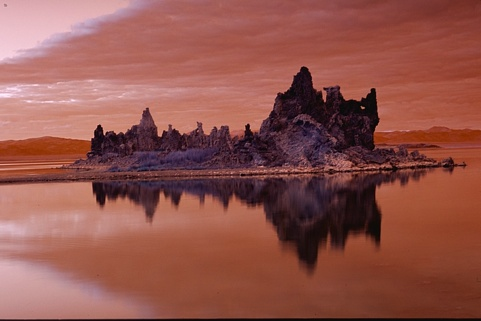

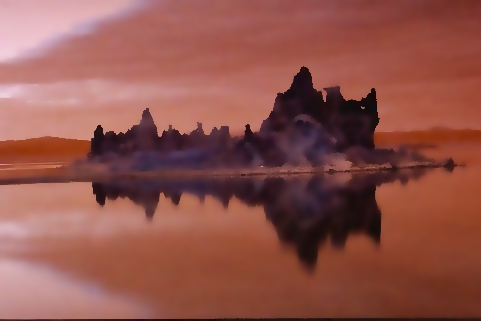

In [ ]:
from skimage import io, metrics

# Load the images
image1 = io.imread('/content/drive/MyDrive/dataset/original/0023.png')
image2 = io.imread('/content/drive/MyDrive/dataset/noisy10/0023.png')

# Compute the SSIM between the two images
ssim = metrics.structural_similarity(image1, image2, multichannel=True)

mse = ((image1 - image2) ** 2).mean()

print("SSIM: ",ssim)
print("MSE:",mse)

cv2_imshow(image1)
cv2_imshow(image2)

FFt and Low pass Filter on Noisy_25

In [ ]:
# Define the path to the folder containing the RGB images
path = "/content/drive/MyDrive/dataset/noisy25"

# Iterate through all the files in the folder
for filename in os.listdir(path):
    # Check if the file is an image
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Read the image
        img = cv2.imread(os.path.join(path, filename))

        #cv2_imshow(img)

        # Split the image into its color channels
        blue, green, red = cv2.split(img)

        # Perform FFT on each color channel
        blue_fourier = fft2(blue)
        green_fourier = fft2(green)
        red_fourier = fft2(red)

        # Perform LPF on each color channel
        rows, cols = img.shape[:2]
        center = [int(rows/2), int(cols/2)]
        blue_fourier[center[0]-30:center[0]+30, center[1]-30:center[1]+30] = 0
        green_fourier[center[0]-30:center[0]+30, center[1]-30:center[1]+30] = 0
        red_fourier[center[0]-30:center[0]+30, center[1]-30:center[1]+30] = 0

        # Perform IFFT on each color channel
        blue_inverse = np.abs(ifft2(blue_fourier))
        green_inverse = np.abs(ifft2(green_fourier))
        red_inverse = np.abs(ifft2(red_fourier))

        # Merge the color channels back together
        img_back = cv2.merge((blue_inverse, green_inverse, red_inverse))

        # Save the image
        cv2.imwrite(os.path.join(path, filename), img_back)

        cv2_imshow(img_back)

In [ ]:
folder_path='/content/drive/MyDrive/dataset/noisy25'

for filename in os.listdir(folder_path):
  if filename.endswith(".jpg") or filename.endswith(".png"):

    img_1 = cv2.imread(os.path.join(folder_path, filename))

    bilateral_filtered_img = cv2.bilateralFilter(img_1, d=9, sigmaColor=75, sigmaSpace=75)
 #cv2.imwrite("bilateral_filtered_image5.jpg", bilateral_filtered_img)

 # Save the image
    cv2.imwrite(os.path.join(folder_path, filename), bilateral_filtered_img)
    

    plt.subplot(1, 2, 1)
    plt.imshow(img_1)
    plt.title("Original_transformed Image")

# Plot the filtered image
    plt.subplot(1, 2, 2)
    plt.imshow(bilateral_filtered_img)
    plt.title("Filtered Image")

    plt.show()


SSIM:  0.8404775696027468
MSE: 39.29827958799921


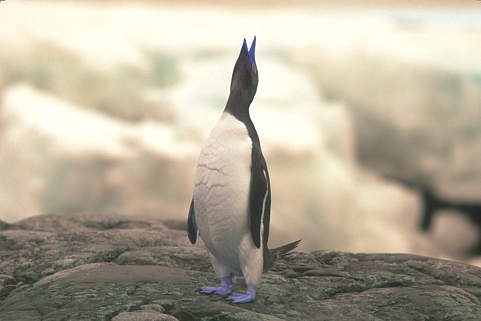

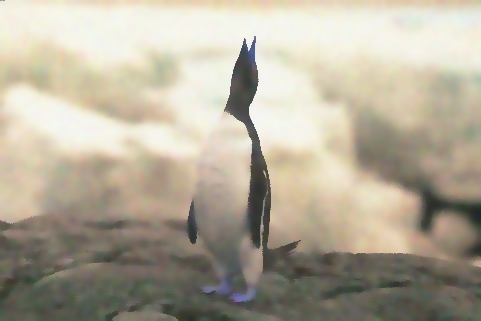

In [ ]:
from skimage import io, metrics

# Load the images
image1 = io.imread('/content/drive/MyDrive/dataset/original/0013.png')
image2 = io.imread('/content/drive/MyDrive/dataset/noisy25/0013.png')

# Compute the SSIM between the two images
ssim = metrics.structural_similarity(image1, image2, multichannel=True)

mse = ((image1 - image2) ** 2).mean()

print("SSIM: ",ssim)
print("MSE:",mse)

cv2_imshow(image1)
cv2_imshow(image2)

FFt and Low pass Filter on Noisy_50

In [ ]:
# Define the path to the folder containing the RGB images
path = "/content/drive/MyDrive/dataset/noisy50"

# Iterate through all the files in the folder
for filename in os.listdir(path):
    # Check if the file is an image
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Read the image
        img = cv2.imread(os.path.join(path, filename))

        #cv2_imshow(img)

        # Split the image into its color channels
        blue, green, red = cv2.split(img)

        # Perform FFT on each color channel
        blue_fourier = fft2(blue)
        green_fourier = fft2(green)
        red_fourier = fft2(red)

        # Perform LPF on each color channel
        rows, cols = img.shape[:2]
        center = [int(rows/2), int(cols/2)]
        blue_fourier[center[0]-30:center[0]+30, center[1]-30:center[1]+30] = 0
        green_fourier[center[0]-30:center[0]+30, center[1]-30:center[1]+30] = 0
        red_fourier[center[0]-30:center[0]+30, center[1]-30:center[1]+30] = 0

        # Perform IFFT on each color channel
        blue_inverse = np.abs(ifft2(blue_fourier))
        green_inverse = np.abs(ifft2(green_fourier))
        red_inverse = np.abs(ifft2(red_fourier))

        # Merge the color channels back together
        img_back = cv2.merge((blue_inverse, green_inverse, red_inverse))

        # Save the image
        cv2.imwrite(os.path.join(path, filename), img_back)

        cv2_imshow(img_back)

In [ ]:
folder_path='/content/drive/MyDrive/dataset/noisy50'

for filename in os.listdir(folder_path):
  if filename.endswith(".jpg") or filename.endswith(".png"):

    img_1 = cv2.imread(os.path.join(folder_path, filename))

    bilateral_filtered_img = cv2.bilateralFilter(img_1, d=9, sigmaColor=75, sigmaSpace=75)
 #cv2.imwrite("bilateral_filtered_image5.jpg", bilateral_filtered_img)

 # Save the image
    cv2.imwrite(os.path.join(folder_path, filename), bilateral_filtered_img)
    

    plt.subplot(1, 2, 1)
    plt.imshow(img_1)
    plt.title("Original_transformed Image")

# Plot the filtered image
    plt.subplot(1, 2, 2)
    plt.imshow(bilateral_filtered_img)
    plt.title("Filtered Image")

    plt.show()

In [ ]:
from skimage import io, metrics

# Load the images
image1 = io.imread('/content/drive/MyDrive/dataset/original/0007.png')
image2 = io.imread('/content/drive/MyDrive/dataset/noisy50/0007.png')



# Compute the SSIM between the two images
ssim = metrics.structural_similarity(image1, image2, multichannel=True)

mse = ((image1 - image2) ** 2).mean()

print("SSIM: ",ssim)
print("MSE:",mse)

cv2_imshow(image1)
cv2_imshow(image2)

Comparing with Mean filter

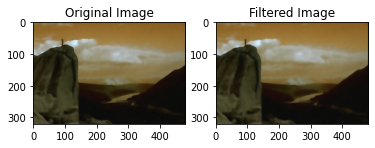

In [ ]:
 #Load the image
original_im= cv2.imread('/content/drive/MyDrive/dataset/noisy10/0002.png')

# Create a 3x3 kernel for the mean filter
kernel = np.ones((3,3),np.float32)/9

# Apply the mean filter to the image
filtered_im = cv2.filter2D(original_im,-1,kernel)

# Save the filtered image
cv2.imwrite("filtered_image.jpg", filtered_im)

plt.subplot(1, 2, 1)
plt.imshow(original_im)
plt.title("Original Image")

# Plot the filtered image
plt.subplot(1, 2, 2)
plt.imshow(filtered_im)
plt.title("Filtered Image")

plt.show()

In [ ]:
from skimage import io, metrics

# Load the images
image1 = io.imread('/content/drive/MyDrive/Task-A-Dataset-denoising/original/0002.png')
image2 = io.imread('/content/filtered_image.png')

# Compute the SSIM between the two images
ssim = metrics.structural_similarity(image1, image2, multichannel=True)

mse = ((image1 - image2) ** 2).mean()

print("SSIM: ",ssim)
print("MSE:",mse)

SSIM:  0.8074932370348517
MSE: 26.969559782643895


Median Filter

In [ ]:

noisy_image = cv2.imread("/content/drive/MyDrive/dataset/noisy25/0023.png")

median_image = cv2.medianBlur(noisy_image, 5)
# Save the filtered image
cv2.imwrite("filtered_image_median.png", median_image)

True

In [ ]:
from skimage import io, metrics

# Load the images
image1 = io.imread('/content/drive/MyDrive/dataset/original/0023.png')
image2 = io.imread('/content/filtered_image_median.png')

# Compute the SSIM between the two images
ssim = metrics.structural_similarity(image1, image2, multichannel=True)

mse = ((image1 - image2) ** 2).mean()

print("SSIM: ",ssim)
print("MSE:",mse)

SSIM:  0.8134726379353848
MSE: 28.952554279657083


Wavelet denoising

In [ ]:
from skimage import restoration
from skimage import data
import matplotlib.pyplot as plt

# load an image
image = (imread("/content/drive/MyDrive/dataset/noisy50/0011.png"))

# denoise the image using BayesShrink
denoised_image = restoration.denoise_wavelet(image, wavelet='db1', method='BayesShrink')



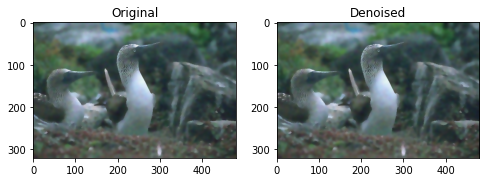

In [ ]:
import matplotlib.pyplot as plt

# create a figure with 2 subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8,3))

# show the original image in the first subplot
ax1.imshow(image, cmap='gray')
ax1.set_title('Original')

# show the denoised image in the second subplot
ax2.imshow(denoised_image, cmap='gray')
ax2.set_title('Denoised')

# display the figure
plt.show()


In [ ]:
from skimage.io import imsave

# Save the denoised image to a file
imsave("denoised_image1.png", denoised_image)

In [ ]:
from skimage import io, metrics

# Load the images
image1 = io.imread('/content/drive/MyDrive/dataset/original/0011.png')
image2 = io.imread('/content/denoised_image1.png')

# Compute the SSIM between the two images
ssim = metrics.structural_similarity(image1, image2, multichannel=True)

mse = ((image1 - image2) ** 2).mean()

print("SSIM: ",ssim)
print("MSE:",mse)

SSIM:  0.7757261062491839
MSE: 43.49426493351727
